Albien-Néocomien libre entre Ornain et limite de district
percentile: 0.1
year: 2022-12-31 00:00:00
Alluvions anciennes de la Plaine de Valence
percentile: 0.2
year: 2022-12-31 00:00:00
Alluvions anciennes de la Vistrenque et des Costières
percentile: 0.4
year: 2022-12-31 00:00:00
Alluvions anciennes entre Vidourle et Lez et littoral entre Montpellier et Sète
percentile: 0.6
year: 2022-12-31 00:00:00
Alluvions anciennes terrasses de Romans et de l'Isère
percentile: 0.2
year: 2022-12-31 00:00:00
Alluvions Aude basse vallée
percentile: 0.4
year: 2022-12-31 00:00:00
Alluvions basse Durance
percentile: 0.4
year: 2022-12-31 00:00:00
Alluvions de l' Isle
percentile: 0.3
year: 2022-12-31 00:00:00
Alluvions de l'Adour amont
percentile: 0.2
year: 2022-12-31 00:00:00
Alluvions de l'Allier amont
percentile: 0.1
year: 2022-12-31 00:00:00
Alluvions de l'Ariège et de l'Hers Vif
percentile: 0.3
year: 2022-12-31 00:00:00
Alluvions de l'Aube
percentile: 0.2
year: 2022-12-31 00:00:00
Alluvions de l'Aude

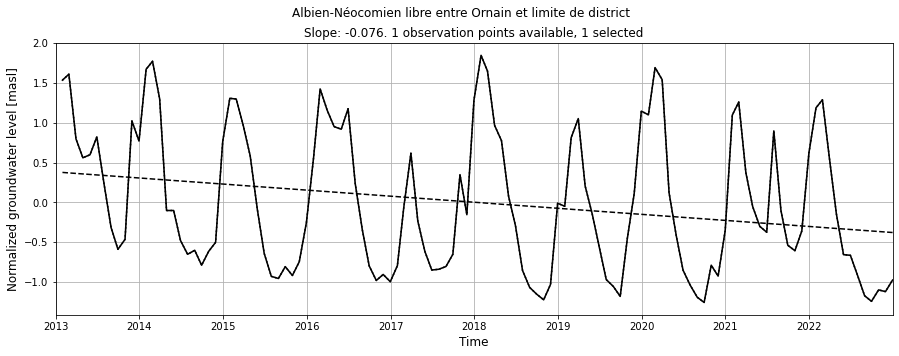

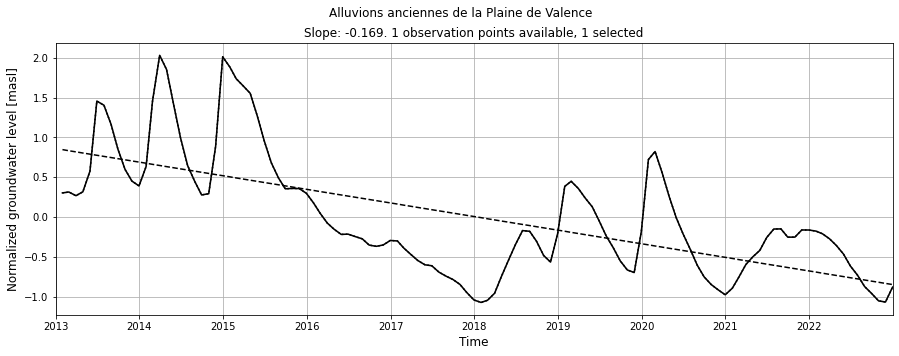

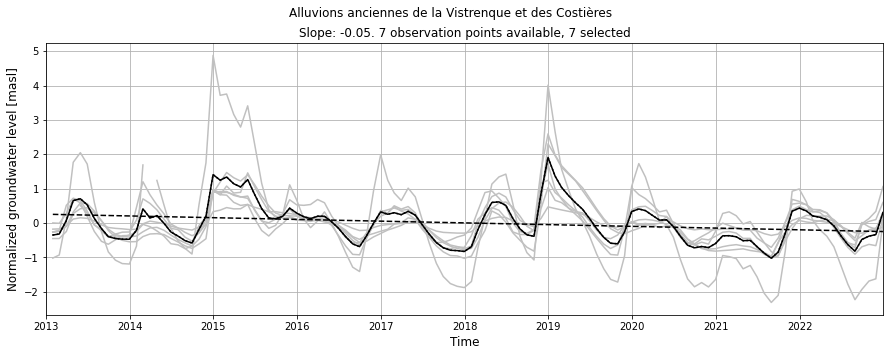

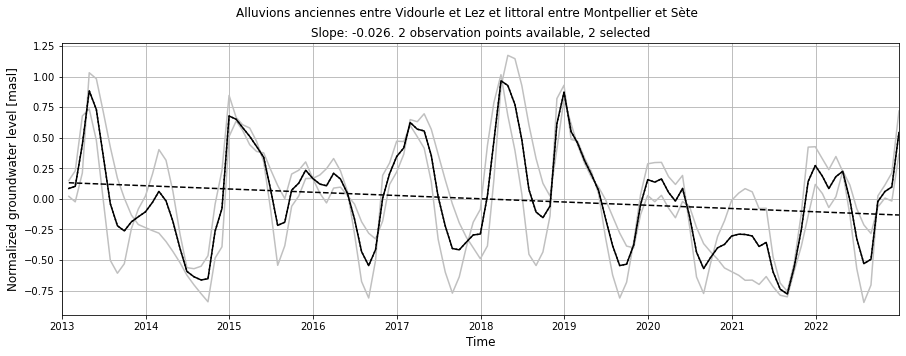

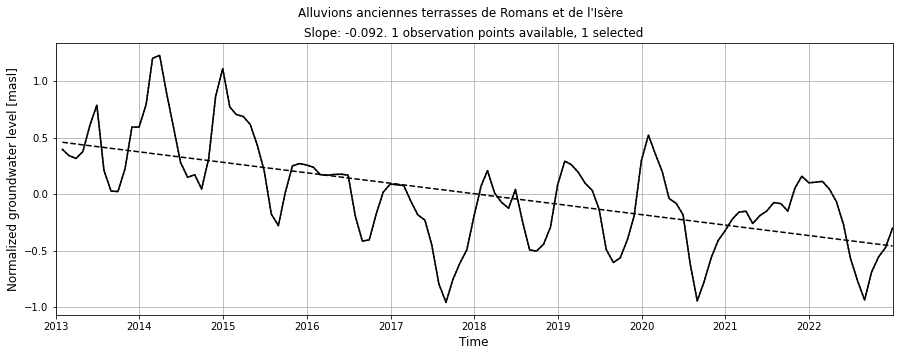

...

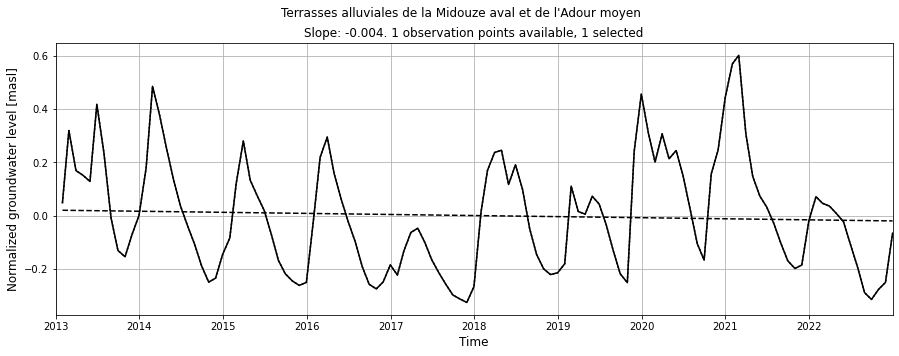

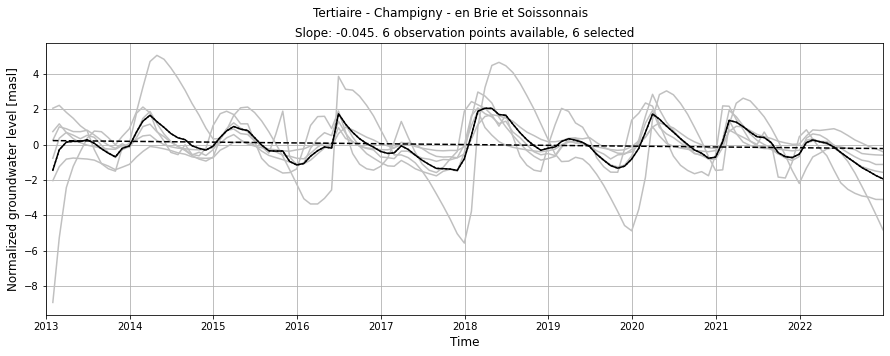

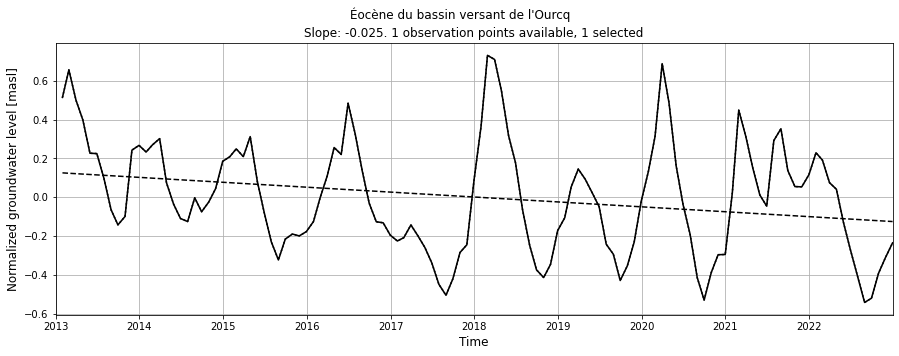

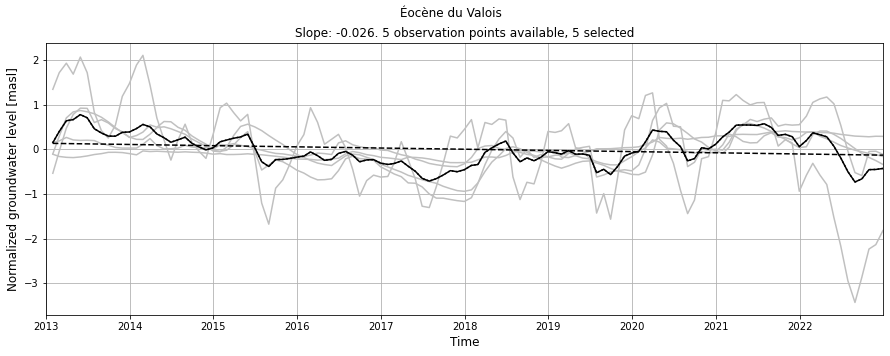

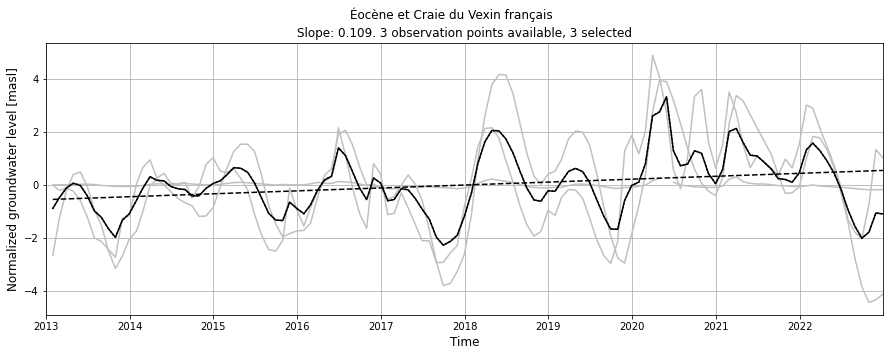

In [3]:
# INTRODUCTION
# This code calculates pluri-annual trends of groundwater levels in aquifers. 

# It takes in input:
#    - A set of CSV files containing the water level monitoring data. Each CSV file corresponds to an individual aquifer. 
#     CSV files are formatted as follow: site / date / level
#     The title of CSV files is the name of the aquifer. For example "Aquifer_X.csv"
#     Site names must start with # if in numerical format

# It creates in output:
#    - A set of PNG files containing the charts of the water level trends (one aquifer per PNG file). 
#    - A CSV summary file containing the list of aquifers and for each aquifer: the number of observation wells used to 
#     calculate the trend, the slope of the trend, whether the trend is stable/rising or declining, etc. This CSV file can be 
#     completed with the area of the aquifers.

# Importing libraries
import numpy as np
import matplotlib
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import os, glob
import warnings; warnings.filterwarnings(action='ignore')

# INITIALIZE THE OUTPUT FILE
list_aquifers = []

# OPENING THE INPUT FILES ONE BY ONE
path = "C:/Users/Admin-AS/Desktop/France-selected wells/"
for filename in glob.glob(os.path.join(path, '*.csv')):   # only input files must be in csv format!
    
    aquifer_name_ext = os.path.basename(filename)
    aquifer_name, ext = os.path.splitext(aquifer_name_ext)
    print(aquifer_name)
    
    # READ INPUT FILE AS A DATAFRAME
    #gdf = pd.DataFrame(pd.read_csv(filename, index_col='date', parse_dates=True, infer_datetime_format=True, encoding='utf8'))
    gdf = pd.DataFrame(pd.read_csv(filename)) #without automatic parsing of dates
    gdf['date'] = pd.to_datetime(gdf['date'], format = '%d/%m/%Y')
    
    gdf.set_index('date', inplace=True)
    #gdf['level'] = gdf['level'].apply(lambda x: x * -0.3048) # converting feet to meters and depth to level
    gdf['level'] = gdf['level'].apply(lambda x: -x)
    #gdf.head()

    # REORGANIZE THE DATA WITH ONE COLUMN PER SITE, AND RESAMPLE DATA AS MEAN MONTHLY VALUES 
    # OVER THE PERIOD 01-01-2013 --> 31/12/2022
    gdf_pivot = gdf.pivot_table(index='date',columns='site',values='level')
    rng = pd.period_range('2013-01-01',periods=120, freq='M').to_timestamp() - pd.DateOffset(day=31)
    gdf_pivot = gdf_pivot.resample('1m').mean().reindex(index=rng)
    gdf_pivot.index.name = "date"
    #gdf_pivot.head()

    # RESAMPLE THE DATA OVER THE PERIOD 01-01-2013 --> 31/12/2022. 
    # In principle the data in input should be within this period, but we resample the data to be sure they are.
    gdf_pivot_1 = gdf_pivot.copy()['01-01-2013':'31-12-2022']
    gdf_pivot_1.head()

    # First glance of the data
    # gdf_pivot_1.plot(figsize=(15,5), legend=False, xlim=[datetime.date(2013, 1, 1), datetime.date(2022, 12, 31)])
    nb_sites_input = gdf_pivot_1.shape[1]
    # print("The number of observation points available is", nb_sites_input)

    # DATA SELECTION
    # This step consists in removing observation wells from the analysis, for instance if they are incomplete. 

    # gdf_1 = gdf_pivot_1.copy().dropna(axis=1) saved formula to remove all time series if at least one value is missing

    # Removing time series if the percentage of missing values is larger than some percentage
    perc_missing = 8/12 # this is like 1 data every 3 months (quarterly data)

    gdf_1 = gdf_pivot_1.copy()
    
    max_number_of_nas = perc_missing*gdf_1.shape[0]
    gdf_1 = gdf_1.loc[:, (gdf_1.isnull().sum(axis=0) <= max_number_of_nas)]
    
    # Removing time series if data are missing for more than 1 year
    gdf_1_year = gdf_1.resample('1y').mean()
    gdf_1_year.index.name = "date"
    
    nb_years_missing = 1

    col_to_drop = [i for i in gdf_1_year.columns if gdf_1_year[i].isnull().sum() > nb_years_missing]
    gdf_1.drop(col_to_drop, inplace = True, axis=1)

    nb_sites = gdf_1.shape[1]
    # print("The number of observation points selected is", nb_sites) 

    # WE CONTINUE IF AT LEAST ONE SITE HAS BEEN SELECTED
    if nb_sites:

        # gdf_1.plot(figsize=(15,5), legend=None, xlim=[datetime.date(2013, 1, 1), datetime.date(2022, 12, 31)])

        # Final dataset to work further in the evaluation
        # gdf_1

        # REORGANIZE THE DATAFRAME AS SITE/ DATE / LEVEL
        gdf_melt = gdf_1.copy() #dataframe from step 3
        gdf_melt = gdf_melt.unstack().reset_index(name='level')
        gdf_melt.set_index('site', inplace=True)
        # gdf_melt

        # CALCULATE MEAN WATER LEVEL PER SITE
        waterlevel_means = gdf_melt.reset_index().groupby('site', as_index=False)['level'].mean()
        waterlevel_means.set_index('site', inplace=True)
        # waterlevel_means

        # ASSIGN MEAN WATER LEVEL TO EACH DATA ROW
        gdf_melt['mean_level'] = gdf_melt.index.map(waterlevel_means['level'])
        # gdf_melt

        # Calculate normalized water level "norm_level"
        gdf_melt['norm_level'] = gdf_melt['level'] - gdf_melt['mean_level']
        # gdf_melt   
    
        # aquifer-averaged dataframe
        final_df1 = gdf_melt[['date', 'norm_level']].groupby('date', as_index=False).mean()

        # CALCULATE LINEAR TREND
        final_df1.loc[:, "date"] = pd.to_datetime(final_df1.loc[:, "date"], format="%d-%b-%y")
        y_values = final_df1.loc[:, "norm_level"]
        x_values = np.linspace(0,1,len(final_df1.loc[:, "norm_level"]))
    
        #cleaning NaN
        idx = np.isfinite(x_values) & np.isfinite(y_values)
        slope,b = np.polyfit(x_values[idx], y_values[idx], 1)
        
        linear_fit = x_values*slope + b


        fig, ax = plt.subplots(figsize=(15,5))

        gdf_pivot = gdf_melt.pivot_table(index='date',columns='site',values='norm_level')    
        plt.plot(gdf_pivot, color='#C0C0C0')     # all the monitoring curves

        plt.plot(final_df1.loc[:, "date"], final_df1.loc[:, "norm_level"], color='#000000') # the composite hydrograph with gaps
        
        final_df2=final_df1.dropna() # the composite hydrograph without gaps
        plt.plot(final_df2.loc[:, "date"], final_df2.loc[:, "norm_level"],color='black', linestyle="dotted") 

        plt.plot(final_df1.loc[:, "date"], linear_fit, color='#000000', linestyle='dashed') # the linear regression

        # axes
        ax.set_xlabel('Time', fontsize = 12)
        ax.set_ylabel('Normalized groundwater level [masl]', fontsize = 12)
        ax.grid()
        plt.xlim([datetime.date(2013, 1, 1), datetime.date(2022, 12, 31)])

        # title
        plt.title("Slope: {}. {} observation points available, {} selected".format(round(slope/10, 3), nb_sites_input, nb_sites))
           # the slope is calculated over 0 --> 1, it has to be 2013.01.01 --> 2022.12.31 (10 years)
        plt.suptitle(aquifer_name)

        # save chart as an image
        fig.savefig(path + aquifer_name + ".pdf", bbox_inches='tight')

        # plt.show()
        
        # CALCULATE PERCENTILE
        year_df = final_df1
        year_df.set_index('date', inplace=True)
        year_df = year_df.resample('Y').mean()
        year_df.dropna()
        year_df['percent_rank'] = year_df.loc[:,'norm_level'].rank(pct=True)
        percentile = year_df.iloc[-1]['percent_rank']
        percentile_year = year_df.index[-1]
        print("percentile: {}\nyear: {}".format(percentile, percentile_year))
    
        # UPDATE THE LIST OF OUTPUTS
        list_aquifers.append((aquifer_name, perc_missing, nb_sites_input, nb_sites, round(slope, 3), percentile, percentile_year))
    
    # IF NO SITE HAS BEEN SELECTED
    else:
        list_aquifers.append((aquifer_name, perc_missing, nb_sites_input, nb_sites, "not enough data"))
     
    
    
# SAVING THE OUTPUT FILE
output_df = pd.DataFrame(list_aquifers, columns=['aquifer', 'threshold', 'nb_sites_input', 'nb_sites_selected', 'slope', 'percentile', 'percentile_year'])
output_df.to_csv(path + '0_Overview.csv', index=True, encoding='utf-8-sig')